In [3]:
# Locate one sample for testing
import os.path

data_directory = os.path.expanduser("~/dbd/humann_data/")

sample = '700175181'

sample_directory = '%s/%s' % (data_directory, sample)

gene_fam_fpath = '%s/%s_1_genefamilies.tsv' % (sample_directory, sample)
path_ab_fpath = '%s/%s_1_pathabundance.tsv' % (sample_directory, sample)
path_cov_fpath = '%s/%s_1_pathcoverage.tsv' % (sample_directory, sample)

In [ ]:
gene_fam_data = {}
with open(gene_fam_fpath, 'r') as file:
    header = file.readline()
    for line in file:
        gene_fam, rpk = line.strip().split('\t')
        gene_fam_data[gene_fam] = rpk

['# Gene Family', '700175181_1_Abundance-RPKs\n']
['UNMAPPED', '7601658.0000000000\n']
['UniRef90_A0A173V0H2', '169633.3333333326\n']
['UniRef90_A0A173V0H2|g__Blautia.s__Blautia_hydrogenotrophica', '169633.3333333326\n']
['UniRef90_A5ZT60', '51029.8507462687\n']
['UniRef90_A5ZT60|g__Blautia.s__Blautia_obeum', '51000.0000000000\n']
['UniRef90_A5ZT60|unclassified', '29.8507462687\n']
['UniRef90_A0A3E5G3Y1', '48494.4109941442\n']
['UniRef90_A0A3E5G3Y1|g__Blautia.s__Blautia_hydrogenotrophica', '22897.3558528350\n']
['UniRef90_A0A3E5G3Y1|g__Fusicatenibacter.s__Fusicatenibacter_saccharivorans', '9923.8312561841\n']
['UniRef90_A0A3E5G3Y1|g__Blautia.s__Blautia_wexlerae', '9739.2705461260\n']
['UniRef90_A0A3E5G3Y1|unclassified', '2237.4563597048\n']
['UniRef90_A0A3E5G3Y1|g__Hungatella.s__Hungatella_hathewayi', '1408.9880952381\n']
['UniRef90_A0A3E5G3Y1|g__Dorea.s__Dorea_longicatena', '1144.2256736374\n']
['UniRef90_A0A3E5G3Y1|g__Dorea.s__Dorea_formicigenerans', '1139.6600220130\n']
['UniRef90_A

In [ ]:
# Percentage unmapped

In [13]:
# dN/dS test

import config
import pickle
import math
import numpy as np
from matplotlib import pyplot as plt

ddir = config.data_directory
pdir = "%s/pickles" % (ddir)

snp_changes = pickle.load(open('%s/big_snp_changes_full.pkl' % (pdir), 'rb'))
snp_change_freqs = pickle.load(open('%s/snp_change_freqs_with_opps_full.pkl' % (pdir), 'rb'))

In [2]:
# Settings for prevalence plots

modification_difference_threshold = config.modification_difference_threshold
replacement_difference_threshold = config.replacement_difference_threshold
default_num_bootstraps = 10000
min_sample_size = 3
min_haploid_sample_size = 10

variant_types = ['1D','4D']
within_host_type = 'consecutive' # consecutive timepoints (vs. longest)

num_bootstraps = 10 # for gene change prevalence null

# For partitioning SNVs according to prevalence
derived_freq_bins = np.array([-1,0,0.01,0.1,0.5,0.9,0.99,1,2])
derived_virtual_freqs = np.arange(0,len(derived_freq_bins)-1)
derived_virtual_xticks = list(derived_virtual_freqs[:-1]+0.5)
derived_virtual_xticklabels = ['0','.01','.1','.5','.9','.99','1']

# For partitioning genes into different prevalence classes
gene_freq_bins = np.array([-1,0.1,0.5,0.9,2])
gene_freq_xticks = [-4, -3, -2, -1, 0, 1, 2, 3, 4]
gene_freq_xticklabels = ['0','0.1','0.5', '0.9','1','0.9','0.5', '0.1','0']
gene_gain_virtual_freqs = np.array([3.5,2.5,1.5,0.5])
gene_loss_virtual_freqs = np.array([-3.5,-2.5,-1.5,-0.5])

# Function
def get_f_idx(f):
    return ((f>derived_freq_bins[:-1])*
            (f<=derived_freq_bins[1:])).argmax()

In [27]:
# "Correct" dN/dS calculation?

variant_types = ['4D', '1D', '2D', '3D']
prev_cohort = 'all'

snp_change_count_by_freq = {vt: np.zeros(len(derived_virtual_freqs)) for vt in variant_types}
qp_pairs_by_freq = [set()] * len(derived_virtual_freqs)
qp_pair_opps_dict = {}

for species in snp_change_freqs:
    for sample_i, sample_j in snp_change_freqs[species]:
        
        # For each SNP change in this QP pair...
        for vartype, freq_dict, syn_opps, non_opps, opp_dict in snp_change_freqs[species][(sample_i, sample_j)]:
            
            f = freq_dict[prev_cohort] # Prevalence
            f_idx = get_f_idx(f) # Prevalence bin
            
            snp_change_count_by_freq[vartype][f_idx] += 1
            qp_pairs_by_freq[f_idx].add((sample_i, sample_j, species))
            
            qp_pair_opps_dict[(sample_i, sample_j, species)] = (non_opps, syn_opps)

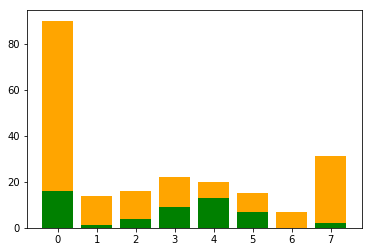

In [28]:
# Quickly plot SNP change counts to make sure it is consistent

idxs = np.arange(len(derived_virtual_freqs))
plt.bar(idxs, snp_change_count_by_freq['4D'], color='green')
plt.bar(idxs, snp_change_count_by_freq['1D'], bottom=snp_change_count_by_freq['4D'], color='orange')
plt.show()

In [29]:
# CALCULATE THAT dN/dS!! Try just for rare bin first

nonsyn_count = snp_change_count_by_freq['1D'][0]
syn_count = snp_change_count_by_freq['4D'][0]

total_non_opps = 0; total_syn_opps = 0

for qp_pair in qp_pairs_by_freq[0]:
    non_opps, syn_opps = qp_pair_opps_dict[qp_pair]
    total_non_opps += non_opps
    total_syn_opps += syn_opps

In [31]:
from __future__ import division
dNdS = (nonsyn_count/float(total_non_opps))/(syn_count/total_syn_opps)
dNdS_alt = (nonsyn_count/syn_count)*(total_syn_opps/total_non_opps)

In [36]:
# CALCULATE THAT dN/dS!! For all bins

nonsyn_count = snp_change_count_by_freq['1D']
syn_count = snp_change_count_by_freq['4D']
total_non_opps = np.zeros(len(derived_virtual_freqs))
total_syn_opps = np.zeros(len(derived_virtual_freqs))

for i in range(len(qp_pairs_by_freq)):
    for qp_pair in qp_pairs_by_freq[i]:
        non_opps, syn_opps = qp_pair_opps_dict[qp_pair]
        total_non_opps[i] += non_opps
        total_syn_opps[i] += syn_opps

dNdSs = (nonsyn_count/syn_count)*(total_syn_opps/total_non_opps)

/u/local/apps/python/2.7.13/lib/python2.7/site-packages/ipykernel/__main__.py:14: RuntimeWarning: divide by zero encountered in true_divide


In [37]:
dNdSs

array([1.06116719, 2.98274021, 0.68832466, 0.33141558, 0.12354545,
       0.26221892,        inf, 3.32690255])

In [16]:
# Try to replicate dN/dS values for HMP1-2

variant_types = ['4D', '1D', '2D', '3D']
prev_cohort = 'all'

snp_change_count_by_freq = {vt: np.zeros(len(derived_virtual_freqs)) for vt in variant_types}
total_opportunities_by_freq = {vt: np.zeros(len(derived_virtual_freqs)) for vt in variant_types}

for species in snp_change_freqs_with_opps:
    for sample_i, sample_j in snp_change_freqs_with_opps[species]:
        # For each SNP change in this QP pair...
        for vartype, freq_dict, opp_dict in snp_change_freqs_with_opps[species][(sample_i, sample_j)]:
            f = freq_dict[prev_cohort]
            f_idx = get_f_idx(f)
            snp_change_count_by_freq[vartype][f_idx] += 1
            for other_vartype in opp_dict:
                if math.isnan(opp_dict[other_vartype]):
                    print('uh oh')
                    continue
                total_opportunities_by_freq[other_vartype][f_idx] += opp_dict[other_vartype]

In [17]:
non_ns = snp_change_count_by_freq['1D']
syn_ns = snp_change_count_by_freq['4D']
non_opportunities = total_opportunities_by_freq['1D']
syn_opportunities = total_opportunities_by_freq['4D']
total_opportunities = non_opportunities + syn_opportunities

observed_dNdSs = non_ns*1.0/syn_ns / (non_opportunities*1.0/syn_opportunities)

/u/local/apps/python/2.7.13/lib/python2.7/site-packages/ipykernel/__main__.py:7: RuntimeWarning: divide by zero encountered in divide


In [18]:
observed_dNdSs

array([1.05882659, 2.91166599, 0.7127657 , 0.34060736, 0.13126743,
       0.27762335,        inf, 3.30817508])

In [5]:
# Figure 3: SNP prevalences

desired_event_type = 'modification'
variant_types = ['4D', '1D', '2D', '3D']
prev_cohort = 'all'

prev_distribution = {variant_type: np.zeros(len(derived_virtual_freqs)) for variant_type in variant_types}
nonsyn_opps_distribution = {variant_type: np.zeros(len(derived_virtual_freqs)) for variant_type in variant_types}
syn_opps_distribution = {variant_type: np.zeros(len(derived_virtual_freqs)) for variant_type in variant_types}

for species in snp_change_freqs:
    for sample_i, sample_j in snp_change_freqs[species]:
        
        pdicts = snp_change_freqs[species][(sample_i, sample_j)] # list of (vartype, freq_dict, opp_dict tuples)        
        snp_change_val = snp_changes[species][(sample_i, sample_j)]
        
        if type(snp_change_val) == type(1):
            event_type = 'replacement'
        elif len(snp_change_val) > 0 and len(snp_change_val) <= modification_difference_threshold:
            event_type = 'modification'
        else:
            continue
        
        if event_type != desired_event_type:
            continue
        
        for vartype, fdict, opp_dict in pdicts:
            f = fdict[prev_cohort]
            f_idx = get_f_idx(f)
            prev_distribution[prev_cohort][tp_type][vartype][f_idx] += 1
            nonsyn_opps_distribution[prev_cohort][tp_type][vartype][f_idx] += nonsyn_opps
            syn_opps_distribution[prev_cohort][tp_type][vartype][f_idx] += syn_opps

{'Acidaminococcus_intestini_54097': defaultdict(list, {}),
 'Akkermansia_muciniphila_55290': defaultdict(list,
             {('700013600',
               '700034565'): [('1D',
                {'all': -0.5},
                {'1D': 0.7860310538069355, '4D': 0.2139689461930645}), ('1D',
                {'all': -0.5},
                {'1D': 0.7860310538069355, '4D': 0.2139689461930645})],
              ('700095647',
               '700108218'): [('2D',
                {'all': -0.5},
                {'1D': 0.7861620531047778, '4D': 0.2138379468952222}), ('1D',
                {'all': 0.0113636},
                {'1D': 0.7861620531047778, '4D': 0.2138379468952222}), ('1D',
                {'all': 0.9791667},
                {'1D': 0.7861620531047778, '4D': 0.2138379468952222}), ('1D',
                {'all': 1.5},
                {'1D': 0.7861620531047778, '4D': 0.2138379468952222}), ('1D',
                {'all': 1.5},
                {'1D': 0.7861620531047778, '4D': 0.2138379468952222})]})